In [3]:
!pip install -q transformers pydub

## Basic Import 

In [3]:
import os
import pandas as pd
import numpy as np

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torchvision
import torchvision.transforms as T
import librosa
import librosa.display
import IPython.display as ipd
import matplotlib.pyplot as plt
import random

# 0. Device Agnostic Code

In [4]:
!nvidia-smi

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


Tue Apr  8 19:15:56 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 560.35.03              Driver Version: 560.35.03      CUDA Version: 12.6     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   35C    P8              9W /   70W |       1MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [5]:
# Set up device agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

# 1. Create DataFrame for the data

In [6]:
TESS = "/kaggle/input/toronto-emotional-speech-set-tess/TESS Toronto emotional speech set data/"
RAV = "/kaggle/input/ravdess-emotional-speech-audio/"
SAVEE = "/kaggle/input/surrey-audiovisual-expressed-emotion-savee/ALL/"
CREMA = "/kaggle/input/cremad/AudioWAV/"

In [7]:
# Get the data location for SAVEE
dir_list = os.listdir(SAVEE)

# parse the filename to get the emotions
emotion=[]
path = []
for i in dir_list:
    if i[-8:-6]=='_a':
        emotion.append('male_angry')
    elif i[-8:-6]=='_d':
        emotion.append('male_disgust')
    elif i[-8:-6]=='_f':
        emotion.append('male_fear')
    elif i[-8:-6]=='_h':
        emotion.append('male_happy')
    elif i[-8:-6]=='_n':
        emotion.append('male_neutral')
    elif i[-8:-6]=='sa':
        emotion.append('male_sad')
    elif i[-8:-6]=='su':
        emotion.append('male_surprise')
    else:
        emotion.append('male_error') 
    path.append(SAVEE + i)

# Now check out the label count distribution 
SAVEE_df = pd.DataFrame(emotion, columns = ['labels'])
SAVEE_df['source'] = 'SAVEE'
SAVEE_df = pd.concat([SAVEE_df, pd.DataFrame(path, columns = ['path'])], axis = 1)
SAVEE_df.labels.value_counts()

labels
male_neutral     120
male_fear         60
male_happy        60
male_disgust      60
male_angry        60
male_surprise     60
male_sad          60
Name: count, dtype: int64

In [9]:
SAVEE_df

,labels,source,path
0,male_happy,SAVEE,/kaggle/input/surrey-audiovisual-expressed-emo...
1,male_fear,SAVEE,/kaggle/input/surrey-audiovisual-expressed-emo...
2,male_happy,SAVEE,/kaggle/input/surrey-audiovisual-expressed-emo...
3,male_disgust,SAVEE,/kaggle/input/surrey-audiovisual-expressed-emo...
4,male_angry,SAVEE,/kaggle/input/surrey-audiovisual-expressed-emo...
...,...,...,...
475,male_surprise,SAVEE,/kaggle/input/surrey-audiovisual-expressed-emo...
476,male_neutral,SAVEE,/kaggle/input/surrey-audiovisual-expressed-emo...
477,male_neutral,SAVEE,/kaggle/input/surrey-audiovisual-expressed-emo...
478,male_angry,SAVEE,/kaggle/input/surrey-audiovisual-expressed-emo...


In [6]:
dir_list = os.listdir(RAV)
dir_list

['Actor_02',
 'Actor_17',
 'Actor_05',
 'Actor_16',
 'Actor_21',
 'Actor_01',
 'Actor_11',
 'Actor_20',
 'Actor_08',
 'Actor_15',
 'Actor_06',
 'Actor_12',
 'Actor_23',
 'Actor_24',
 'Actor_22',
 'Actor_04',
 'Actor_19',
 'Actor_10',
 'Actor_09',
 'audio_speech_actors_01-24',
 'Actor_14',
 'Actor_03',
 'Actor_13',
 'Actor_18',
 'Actor_07']

In [8]:

dir_list = os.listdir(RAV)
dir_list.sort()

emotion = []
path = []

# Iterate over all the directories in the RAVDESS dataset
for directory in dir_list:
    if directory == "audio_speech_actors_01-24":
        continue
    fname = os.listdir(RAV + directory)
    for f in fname:
        part = f.split('.')[0].split('-')
        emotion_code = int(part[2])
        
        # Replace numeric emotion codes with corresponding emotion names
        if emotion_code == 1:
            emotion.append('neutral')
        elif emotion_code == 2:
            emotion.append('neutral')
        elif emotion_code == 3:
            emotion.append('happy')
        elif emotion_code == 4:
            emotion.append('sad')
        elif emotion_code == 5:
            emotion.append('angry')
        elif emotion_code == 6:
            emotion.append('fear')
        elif emotion_code == 7:
            emotion.append('disgust')
        elif emotion_code == 8:
            emotion.append('surprise')

        # Store the path of the audio file
        path.append(RAV + directory + '/' + f)

# Create a DataFrame with the emotion labels and paths
RAV_df = pd.DataFrame(emotion, columns=['emotion'])
RAV_df['path'] = path

# Create the final labels (just the emotion)
RAV_df['labels'] = RAV_df['emotion']

# Add source column for dataset origin
RAV_df['source'] = 'RAVDESS'

# Display label counts
print(RAV_df['labels'].value_counts())


labels
neutral     288
sad         192
fear        192
happy       192
disgust     192
angry       192
surprise    192
Name: count, dtype: int64


In [9]:
RAV_df

,emotion,path,labels,source
0,neutral,/kaggle/input/ravdess-emotional-speech-audio/A...,neutral,RAVDESS
1,neutral,/kaggle/input/ravdess-emotional-speech-audio/A...,neutral,RAVDESS
2,sad,/kaggle/input/ravdess-emotional-speech-audio/A...,sad,RAVDESS
3,neutral,/kaggle/input/ravdess-emotional-speech-audio/A...,neutral,RAVDESS
4,neutral,/kaggle/input/ravdess-emotional-speech-audio/A...,neutral,RAVDESS
...,...,...,...,...
1435,happy,/kaggle/input/ravdess-emotional-speech-audio/A...,happy,RAVDESS
1436,happy,/kaggle/input/ravdess-emotional-speech-audio/A...,happy,RAVDESS
1437,neutral,/kaggle/input/ravdess-emotional-speech-audio/A...,neutral,RAVDESS
1438,surprise,/kaggle/input/ravdess-emotional-speech-audio/A...,surprise,RAVDESS


In [13]:
dir_list = os.listdir(TESS)
dir_list.sort()

path = []
emotion = []

for directory in dir_list:
    if directory == "tess toronto emotional speech set data":
        continue
    fname = os.listdir(TESS + directory)

    for f in fname:
        if directory == 'OAF_angry' or directory == 'YAF_angry':
            emotion.append('female_angry')
        elif directory == 'OAF_disgust' or directory == 'YAF_disgust':
            emotion.append('female_disgust')
        elif directory == 'OAF_Fear' or directory == 'YAF_fear':
            emotion.append('female_fear')
        elif directory == 'OAF_happy' or directory == 'YAF_happy':
            emotion.append('female_happy')
        elif directory == 'OAF_neutral' or directory == 'YAF_neutral':
            emotion.append('female_neutral')                                
        elif directory == 'OAF_Pleasant_surprise' or directory == 'YAF_pleasant_surprised':
            emotion.append('female_surprise')               
        elif directory == 'OAF_Sad' or directory == 'YAF_sad':
            emotion.append('female_sad')
        else:
            emotion.append('Unknown')
        path.append(TESS + directory + "/" + f)

TESS_df = pd.DataFrame(emotion, columns = ['labels'])
TESS_df['source'] = 'TESS'
TESS_df = pd.concat([TESS_df,pd.DataFrame(path, columns = ['path'])], axis=1)
TESS_df.labels.value_counts()

labels
female_fear        400
female_surprise    400
female_sad         400
female_angry       400
female_disgust     400
female_happy       400
female_neutral     400
Name: count, dtype: int64

In [14]:
TESS_df

,labels,source,path
0,female_fear,TESS,/kaggle/input/toronto-emotional-speech-set-tes...
1,female_fear,TESS,/kaggle/input/toronto-emotional-speech-set-tes...
2,female_fear,TESS,/kaggle/input/toronto-emotional-speech-set-tes...
3,female_fear,TESS,/kaggle/input/toronto-emotional-speech-set-tes...
4,female_fear,TESS,/kaggle/input/toronto-emotional-speech-set-tes...
...,...,...,...
2795,female_sad,TESS,/kaggle/input/toronto-emotional-speech-set-tes...
2796,female_sad,TESS,/kaggle/input/toronto-emotional-speech-set-tes...
2797,female_sad,TESS,/kaggle/input/toronto-emotional-speech-set-tes...
2798,female_sad,TESS,/kaggle/input/toronto-emotional-speech-set-tes...


In [15]:
dir_list = os.listdir(CREMA)
dir_list.sort()

gender = []
emotion = []
path = []
female = [1002,1003,1004,1006,1007,1008,1009,1010,1012,1013,1018,1020,1021,1024,1025,1028,1029,1030,1037,1043,1046,1047,1049,
          1052,1053,1054,1055,1056,1058,1060,1061,1063,1072,1073,1074,1075,1076,1078,1079,1082,1084,1089,1091]

for i in dir_list: 
    part = i.split('_')
    if int(part[0]) in female:
        temp = 'female'
    else:
        temp = 'male'
    gender.append(temp)
    if part[2] == 'SAD' and temp == 'male':
        emotion.append('male_sad')
    elif part[2] == 'ANG' and temp == 'male':
        emotion.append('male_angry')
    elif part[2] == 'DIS' and temp == 'male':
        emotion.append('male_disgust')
    elif part[2] == 'FEA' and temp == 'male':
        emotion.append('male_fear')
    elif part[2] == 'HAP' and temp == 'male':
        emotion.append('male_happy')
    elif part[2] == 'NEU' and temp == 'male':
        emotion.append('male_neutral')
    elif part[2] == 'SAD' and temp == 'female':
        emotion.append('female_sad')
    elif part[2] == 'ANG' and temp == 'female':
        emotion.append('female_angry')
    elif part[2] == 'DIS' and temp == 'female':
        emotion.append('female_disgust')
    elif part[2] == 'FEA' and temp == 'female':
        emotion.append('female_fear')
    elif part[2] == 'HAP' and temp == 'female':
        emotion.append('female_happy')
    elif part[2] == 'NEU' and temp == 'female':
        emotion.append('female_neutral')
    else:
        emotion.append('Unknown')
    path.append(CREMA + i)
    
CREMA_df = pd.DataFrame(emotion, columns = ['labels'])
CREMA_df['source'] = 'CREMA'
CREMA_df = pd.concat([CREMA_df,pd.DataFrame(path, columns = ['path'])],axis=1)
CREMA_df.labels.value_counts()

labels
male_angry        671
male_disgust      671
male_fear         671
male_happy        671
male_sad          671
female_angry      600
female_disgust    600
female_fear       600
female_sad        600
female_happy      600
male_neutral      575
female_neutral    512
Name: count, dtype: int64

In [16]:
CREMA_df

,labels,source,path
0,male_angry,CREMA,/kaggle/input/cremad/AudioWAV/1001_DFA_ANG_XX.wav
1,male_disgust,CREMA,/kaggle/input/cremad/AudioWAV/1001_DFA_DIS_XX.wav
2,male_fear,CREMA,/kaggle/input/cremad/AudioWAV/1001_DFA_FEA_XX.wav
3,male_happy,CREMA,/kaggle/input/cremad/AudioWAV/1001_DFA_HAP_XX.wav
4,male_neutral,CREMA,/kaggle/input/cremad/AudioWAV/1001_DFA_NEU_XX.wav
...,...,...,...
7437,female_disgust,CREMA,/kaggle/input/cremad/AudioWAV/1091_WSI_DIS_XX.wav
7438,female_fear,CREMA,/kaggle/input/cremad/AudioWAV/1091_WSI_FEA_XX.wav
7439,female_happy,CREMA,/kaggle/input/cremad/AudioWAV/1091_WSI_HAP_XX.wav
7440,female_neutral,CREMA,/kaggle/input/cremad/AudioWAV/1091_WSI_NEU_XX.wav


## 1.2 Convert Label to classes

In [10]:
labels = ['angry', 'disgust', 'fear', 'happy', 'neutral', 'sad', 'surprise']


In [11]:
def label_to_class(label, labels_list):
    if label in labels_list:
        return labels_list.index(label)

In [12]:
RAV_df['label_class'] = RAV_df['labels'].apply(lambda x: label_to_class(x, labels))

In [13]:
RAV_df.label_class.value_counts()

label_class
4    288
5    192
2    192
3    192
1    192
0    192
6    192
Name: count, dtype: int64

## 1.3 Calculate duration of each clips

In [41]:
from pydub import AudioSegment

def calculate_duration(audio_file_path):
    audio = AudioSegment.from_file(audio_file_path)

    # Calculate duration in seconds
    duration = audio.duration_seconds
    return duration

In [42]:
RAV_df['duration'] = RAV_df['path'].apply(lambda x: calculate_duration(x))

## 2. Data Visualization

In [23]:
# import pandas as pd
# df = pd.read_csv("/content/drive/MyDrive/Kaggle_emotional_data_path.csv", index_col=0)
RAV_df

,emotion,path,labels,source,label_class
1240,neutral,/kaggle/input/ravdess-emotional-speech-audio/A...,neutral,RAVDESS,4
1288,neutral,/kaggle/input/ravdess-emotional-speech-audio/A...,neutral,RAVDESS,4
272,fear,/kaggle/input/ravdess-emotional-speech-audio/A...,fear,RAVDESS,2
282,disgust,/kaggle/input/ravdess-emotional-speech-audio/A...,disgust,RAVDESS,1
73,fear,/kaggle/input/ravdess-emotional-speech-audio/A...,fear,RAVDESS,2
...,...,...,...,...,...
712,neutral,/kaggle/input/ravdess-emotional-speech-audio/A...,neutral,RAVDESS,4
1219,fear,/kaggle/input/ravdess-emotional-speech-audio/A...,fear,RAVDESS,2
636,happy,/kaggle/input/ravdess-emotional-speech-audio/A...,happy,RAVDESS,3
297,happy,/kaggle/input/ravdess-emotional-speech-audio/A...,happy,RAVDESS,3


## 2.1 Shuffle the datasets

In [14]:
from sklearn.utils import shuffle

RAV_df = shuffle(RAV_df)
RAV_df

,emotion,path,labels,source,label_class
1086,sad,/kaggle/input/ravdess-emotional-speech-audio/A...,sad,RAVDESS,5
1316,neutral,/kaggle/input/ravdess-emotional-speech-audio/A...,neutral,RAVDESS,4
1154,surprise,/kaggle/input/ravdess-emotional-speech-audio/A...,surprise,RAVDESS,6
1209,sad,/kaggle/input/ravdess-emotional-speech-audio/A...,sad,RAVDESS,5
1424,neutral,/kaggle/input/ravdess-emotional-speech-audio/A...,neutral,RAVDESS,4
...,...,...,...,...,...
1168,neutral,/kaggle/input/ravdess-emotional-speech-audio/A...,neutral,RAVDESS,4
875,disgust,/kaggle/input/ravdess-emotional-speech-audio/A...,disgust,RAVDESS,1
918,fear,/kaggle/input/ravdess-emotional-speech-audio/A...,fear,RAVDESS,2
1087,sad,/kaggle/input/ravdess-emotional-speech-audio/A...,sad,RAVDESS,5


## 2.2 Drop all long clips (audio > 4 sec)

Since we got over 10k data, we can cut some long clips off to save some computational power

In [45]:
RAV_df.sort_values(by="duration")

,emotion,path,labels,source,label_class,duration
732,neutral,/kaggle/input/ravdess-emotional-speech-audio/A...,neutral,RAVDESS,4,2.936271
608,surprise,/kaggle/input/ravdess-emotional-speech-audio/A...,surprise,RAVDESS,6,2.969625
731,neutral,/kaggle/input/ravdess-emotional-speech-audio/A...,neutral,RAVDESS,4,3.003000
769,neutral,/kaggle/input/ravdess-emotional-speech-audio/A...,neutral,RAVDESS,4,3.036354
768,surprise,/kaggle/input/ravdess-emotional-speech-audio/A...,surprise,RAVDESS,6,3.036375
...,...,...,...,...,...,...
1133,disgust,/kaggle/input/ravdess-emotional-speech-audio/A...,disgust,RAVDESS,1,4.904896
1084,disgust,/kaggle/input/ravdess-emotional-speech-audio/A...,disgust,RAVDESS,1,4.938271
40,fear,/kaggle/input/ravdess-emotional-speech-audio/A...,fear,RAVDESS,2,5.005000
1433,angry,/kaggle/input/ravdess-emotional-speech-audio/A...,angry,RAVDESS,0,5.105104


## 2.3 Create functions for visualize data

In [29]:
## Change the name first
## Maybe add some mfcc features

def load_audio(AUDIO_PATH):
    audio, sr = librosa.load(AUDIO_PATH, sr=44100)
    return audio, sr

def wav2melSpec(AUDIO_PATH):
    audio, sr = librosa.load(AUDIO_PATH)
    return librosa.feature.melspectrogram(y=audio, sr=sr)

def imgSpec(ms_feature):
    fig, ax = plt.subplots()
    ms_dB = librosa.power_to_db(ms_feature, ref=np.max)
    print(ms_feature.shape)
    img = librosa.display.specshow(ms_dB, x_axis='time', y_axis='mel', ax=ax)
    fig.colorbar(img, ax=ax, format='%+2.0f dB')
    ax.set(title='Mel-frequency spectrogram');
    
def hear_audio(AUDIO_PATH):
    audio, sr = librosa.load(AUDIO_PATH)
    
    print("\t", end="")
    ipd.display(ipd.Audio(data=audio, rate=sr))
    
    
def get_audio_info(path, show_melspec=False, label=None):
    spec = wav2melSpec(path)
    if label is not None:
        print("Label:", label)
    if show_melspec is not False:
        imgSpec(spec)
    hear_audio(path)

(128, 196)
	

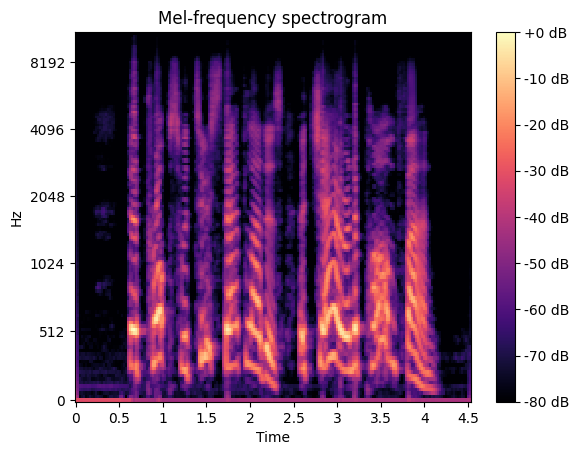

In [27]:
get_audio_info('/kaggle/input/surrey-audiovisual-expressed-emotion-savee/ALL/JK_f11.wav', show_melspec=True)

# 3. Create DataLoader

In [16]:
from torch.utils.data import Dataset
import librosa
import numpy as np
import torch

class AudioDataset(Dataset):
    def __init__(self, df, data_col, label_col, max_length=4*16000, new_sr=16000, train=True, train_size=0.80):
        self.file_path_list = df[data_col].tolist()
        self.label_list = df[label_col].tolist()
        self.max_length = max_length
        self.new_sr = new_sr

        total_len = len(self.file_path_list)
        
        if train:
            self.file_path_list = self.file_path_list[:int(train_size * total_len)]
            self.label_list = self.label_list[:int(train_size * total_len)]
        else:
            self.file_path_list = self.file_path_list[int(train_size * total_len):]
            self.label_list = self.label_list[int(train_size * total_len):]

    def __len__(self):
        return len(self.file_path_list)

    def __getitem__(self, idx):
        # Load the audio file
        audio, sample_rate = librosa.load(self.file_path_list[idx], sr=None)
        
        # Resample if necessary
        if sample_rate != self.new_sr:
            audio = librosa.resample(audio, orig_sr=sample_rate, target_sr=self.new_sr)
        
        # Pad or trim the audio to the desired length
        if len(audio) < self.max_length:
            padding = self.max_length - len(audio)
            audio = np.pad(audio, (0, padding), 'constant')
        else:
            audio = audio[:self.max_length]
        
        # Normalize the audio
        audio = audio / np.max(np.abs(audio)) if np.max(np.abs(audio)) > 0 else audio

        # Convert to PyTorch tensor
        audio_tensor = torch.tensor(audio, dtype=torch.float32)
        label_tensor = torch.tensor(self.label_list[idx], dtype=torch.long)

        return audio_tensor, label_tensor, self.file_path_list[idx]


In [17]:
BATCH_SIZE = 16

train_dataset = AudioDataset(RAV_df, 'path', 'label_class', train=True)
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

test_dataset = AudioDataset(RAV_df, 'path', 'label_class', train=False)
test_dataloader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True)

print(len(train_dataset), len(test_dataset))


1152 288


In [18]:
# Calculate total number of batches in train and test datasets
train_batches = len(train_dataset) // BATCH_SIZE + (1 if len(train_dataset) % BATCH_SIZE != 0 else 0)
test_batches = len(test_dataset) // BATCH_SIZE + (1 if len(test_dataset) % BATCH_SIZE != 0 else 0)

print(f"Total number of batches in the train dataset: {train_batches}")
print(f"Total number of batches in the test dataset: {test_batches}")


Total number of batches in the train dataset: 72
Total number of batches in the test dataset: 18


In [19]:
print(f"Training samples: {len(train_dataset)}")  # Should be ~1152
print(f"Test samples: {len(test_dataset)}")       # Should be ~288


Training samples: 1152
Test samples: 288


In [20]:
for batch, (X, y, paths) in enumerate(train_dataloader):
    print(X.shape)  # Output should be [16, 1, 64000]
    print(y.shape)  # Output should be [16,]

torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 64000])
torch.Size([16])
torch.Size([16, 

In [21]:
 # Visualize the shape of the data in dataloader
 max_length = 0
 for batch_idx, (audio_batch, label_batch, file_path) in enumerate(train_dataset):
     print(audio_batch.shape, label_batch, file_path)
     if audio_batch.shape[0] > max_length:
         max_length = audio_batch.shape[0]
 print(f"max length = {max_length}")

torch.Size([64000]) tensor(5) /kaggle/input/ravdess-emotional-speech-audio/Actor_19/03-01-04-01-01-01-19.wav
torch.Size([64000]) tensor(4) /kaggle/input/ravdess-emotional-speech-audio/Actor_22/03-01-02-02-02-02-22.wav
torch.Size([64000]) tensor(6) /kaggle/input/ravdess-emotional-speech-audio/Actor_20/03-01-08-02-01-02-20.wav
torch.Size([64000]) tensor(5) /kaggle/input/ravdess-emotional-speech-audio/Actor_21/03-01-04-02-01-02-21.wav
torch.Size([64000]) tensor(4) /kaggle/input/ravdess-emotional-speech-audio/Actor_24/03-01-01-01-01-01-24.wav
torch.Size([64000]) tensor(4) /kaggle/input/ravdess-emotional-speech-audio/Actor_12/03-01-02-02-02-01-12.wav
torch.Size([64000]) tensor(5) /kaggle/input/ravdess-emotional-speech-audio/Actor_05/03-01-04-02-01-02-05.wav
torch.Size([64000]) tensor(2) /kaggle/input/ravdess-emotional-speech-audio/Actor_08/03-01-06-02-02-01-08.wav
torch.Size([64000]) tensor(0) /kaggle/input/ravdess-emotional-speech-audio/Actor_20/03-01-05-02-02-02-20.wav
torch.Size([64000])

# 4. Model Building

## 4.1 HuBERT from Transformers (huggingface)
Assume that the audio is represented as an **numpy array** with a shape of (time_frames, )

- output_size of Wav2Vec2FeatureExtractor = (batch_size, num_channels, time_frames)
  - Remove num_channels before go into the hubert model

- output_size of hubert = (batch_size, time_frames, frequency_bins). 



***Remarks:*** The number of channels is 1 because audio typically only has one channel.

#### Model Architecture

In [22]:
import torchaudio
from transformers import HubertModel, Wav2Vec2FeatureExtractor

# Create feature extractor
model_id = "facebook/hubert-base-ls960"
feature_extractor = Wav2Vec2FeatureExtractor.from_pretrained(model_id)

# Load the Hubert model and tokenizer
hubert_base = HubertModel.from_pretrained(model_id)


class HubertAudioModel(torch.nn.Module):
    def __init__(self, hubert_model=hubert_base):
        super().__init__()
        self.hubert = hubert_model
        self.fc1 = torch.nn.Linear(199*768, 256)
        self.fc2 = torch.nn.Linear(256,7)

    def forward(self, audio_array):
        # Resample the audio to the required sample rate (16kHz for Hubert)
        # audio_array = librosa.load(audio_file, sr=16000, mono=False)[0]
        # print(f"audio_array shape before Wav2Vec: {audio_array.shape}")
        input = feature_extractor(audio_array, 
                           sampling_rate=16000,
                           padding=True, 
                           return_tensors='pt').to(device)
        
        # print(f"input.input_values shape after Wav2Vec: {input.input_values.shape}")

        input = input.input_values.squeeze(dim=0)
        

        # Pass the spectrogram through the Hubert model
        output = self.hubert(input)
        # print(f"output.last_hidden_state shape after hubert: {output.last_hidden_state.shape}")

        # Flatten the output of the Hubert model
        output = torch.flatten(output.last_hidden_state, start_dim=1)

        # print(f"output shape after flatten: {output.shape}")

        # Pass the flattened output through two dense layers
        output = torch.nn.functional.relu(self.fc1(output))
        output = self.fc2(output)

        return output

In [23]:
model = HubertAudioModel().to(device)

next(model.parameters()).device

device(type='cuda', index=0)

# 5. Setup Loss function, Optimizers & Metrics: Accuracy function

In [24]:
# Loss function
loss_fn = nn.CrossEntropyLoss() # Multi-category loss

# Create an optimizer
optimizer = torch.optim.SGD(params=model.parameters(), lr=0.005)

In [25]:
# Calculate accuracy (a classification metric)
def accuracy_fn(y_true, y_pred):
    correct = torch.eq(y_true, y_pred).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct / len(y_pred)) * 100 
    return acc

# 6. Create Training & Testing Loop

In [26]:
def train_step(model: torch.nn.Module, data_loader: torch.utils.data.DataLoader, 
               loss_fn: torch.nn.Module, optimizer: torch.optim.Optimizer, accuracy_fn, 
               device: torch.device = device):

    train_loss, train_acc = 0, 0

    # Put model into training mode
    model.train() 

    # Add a loop to loop through training batches
    for batch, (X, y, file_path) in enumerate(data_loader):
        # Put data on target device
        X, y = X.to(device), y.to(device)

        # 1. Forward pass
        y_logits = model(X).to(device)
        y_pred = torch.softmax(y_logits, dim=1).argmax(dim=1).to(device)

        # 2.1 Calculate loss (per batch)
        loss = loss_fn(y_logits, y)
        train_loss += loss # accumulatively add up the loss per epoch 
        
        # 2.2 Calculate accuracy (per batch)
        acc = accuracy_fn(y_true=y, y_pred=y_pred)
        train_acc += acc

        # 3. Optimizer zero grad
        optimizer.zero_grad()

        # 4. Loss backward
        loss.backward()

        # 5. Optimizer step
        optimizer.step()

        if batch % 12 == 0:
            sample = random.randint(0, BATCH_SIZE-2)
            print(f"\tBatch {batch}: Train loss: {loss:.5f} | Train accuracy : {acc:.2f}%")
            get_audio_info(file_path[sample], label=y_pred[sample].item())
            print("----------------------------------------")

    # Divide total train loss and accuracy by length of train dataloader (average loss per batch per epoch)
    train_loss /= len(data_loader)
    train_acc /= len(data_loader)

    
    print(f"Train loss: {train_loss:.5f} | Train acc: {train_acc:.2f}%\n")

In [27]:
def test_step(model: torch.nn.Module, data_loader: torch.utils.data.DataLoader, 
              loss_fn: torch.nn.Module, accuracy_fn, device: torch.device = device):
    ### Testing
    # Setup variables for accumulatively adding up loss and accuracy 
    test_loss, test_acc = 0, 0

    # Put the model in eval mode
    model.eval()

    # Turn on inference mode context manager
    with torch.inference_mode():
        for batch, (X, y, file_path) in enumerate(data_loader):
            # Send the data to the target device
            X, y = X.to(device), y.to(device)

            # 1. Forward pass
            test_logits = model(X)
            test_pred = torch.softmax(test_logits, dim=1).argmax(dim=1).to(device)
           
            # 2. Calculate loss / acc (accumatively)
            loss = loss_fn(test_logits, y)
            test_loss += loss

            # 3. Calculate accuracy (preds need to be same as y_true)
            acc = accuracy_fn(y_true=y, y_pred=test_pred)
            test_acc += acc

            if batch % 12 == 0:
                sample = random.randint(0, BATCH_SIZE-2)
                print(f"\tBatch {batch}: Test loss: {test_loss:.5f} | Test accuracy : {acc:.2f}%")
                get_audio_info(file_path[sample], label=test_pred[sample].item())
                print("----------------------------------------")

        
        # Calculations on test metrics need to happen inside torch.inference_mode()
        # Divide total test loss / accuracy by length of test dataloader (per batch)
        test_loss /= len(data_loader)
        test_acc /= len(data_loader)
   
        print(f"Test loss: {test_loss:.5f}, Test acc: {test_acc:.2f}%\n")


# 7. Train the model

In [ ]:
from tqdm.auto import tqdm

# Set the seed
# torch.manual_seed(42)

# Set epochs
epochs =20

# Create a optimization and evaluation loop using train_step() and test_step()
for epoch in tqdm(range(epochs)):
    print(f"Epoch: {epoch}\n-------")
    train_step(model=model, data_loader=train_dataloader, loss_fn=loss_fn, 
               optimizer=optimizer, accuracy_fn=accuracy_fn, device=device)
    
    test_step(model=model, data_loader=test_dataloader, loss_fn=loss_fn, 
              accuracy_fn=accuracy_fn, device=device)


  0%|          | 0/20 [00:00<?, ?it/s]

Epoch: 0
-------
	Batch 0: Train loss: 1.94119 | Train accuracy : 12.50%
Label: 5
	

----------------------------------------
	Batch 12: Train loss: 1.84390 | Train accuracy : 25.00%
Label: 0
	

----------------------------------------
	Batch 24: Train loss: 1.53932 | Train accuracy : 37.50%
Label: 4
	

----------------------------------------
	Batch 36: Train loss: 1.80752 | Train accuracy : 25.00%
Label: 3
	

----------------------------------------
	Batch 48: Train loss: 1.31775 | Train accuracy : 50.00%
Label: 1
	

----------------------------------------
	Batch 60: Train loss: 1.53840 | Train accuracy : 43.75%
Label: 3
	

----------------------------------------
Train loss: 1.70175 | Train acc: 32.55%

	Batch 0: Test loss: 1.67386 | Test accuracy : 18.75%
Label: 2
	

----------------------------------------
	Batch 12: Test loss: 19.57946 | Test accuracy : 50.00%
Label: 5
	

----------------------------------------
Test loss: 1.51031, Test acc: 34.72%

Epoch: 1
-------
	Batch 0: Train loss: 1.04220 | Train accuracy : 50.00%
Label: 6
	

----------------------------------------
	Batch 12: Train loss: 1.08577 | Train accuracy : 75.00%
Label: 3
	

----------------------------------------
	Batch 24: Train loss: 1.66043 | Train accuracy : 25.00%
Label: 2
	

----------------------------------------
	Batch 36: Train loss: 1.28115 | Train accuracy : 56.25%
Label: 1
	

----------------------------------------
	Batch 48: Train loss: 1.11590 | Train accuracy : 62.50%
Label: 4
	

----------------------------------------
	Batch 60: Train loss: 1.00230 | Train accuracy : 56.25%
Label: 0
	

----------------------------------------
Train loss: 1.31656 | Train acc: 50.09%

	Batch 0: Test loss: 1.34959 | Test accuracy : 50.00%
Label: 4
	

----------------------------------------
	Batch 12: Test loss: 17.34848 | Test accuracy : 56.25%
Label: 6
	

----------------------------------------
Test loss: 1.39695, Test acc: 48.96%

Epoch: 2
-------
	Batch 0: Train loss: 1.10637 | Train accuracy : 43.75%
Label: 2
	

----------------------------------------
	Batch 12: Train loss: 0.85898 | Train accuracy : 75.00%
Label: 0
	

----------------------------------------
	Batch 24: Train loss: 0.88161 | Train accuracy : 81.25%
Label: 0
	

----------------------------------------
	Batch 36: Train loss: 1.04026 | Train accuracy : 62.50%
Label: 1
	

----------------------------------------
	Batch 48: Train loss: 0.84814 | Train accuracy : 68.75%
Label: 1
	

----------------------------------------
	Batch 60: Train loss: 1.08535 | Train accuracy : 62.50%
Label: 3
	

----------------------------------------
Train loss: 0.97566 | Train acc: 64.67%

	Batch 0: Test loss: 1.31422 | Test accuracy : 43.75%
Label: 1
	

----------------------------------------
	Batch 12: Test loss: 16.49767 | Test accuracy : 50.00%
Label: 0
	

----------------------------------------
Test loss: 1.23718, Test acc: 55.90%

Epoch: 3
-------
	Batch 0: Train loss: 0.78820 | Train accuracy : 75.00%
Label: 5
	

----------------------------------------
	Batch 12: Train loss: 0.86374 | Train accuracy : 75.00%
Label: 5
	

----------------------------------------
	Batch 24: Train loss: 0.62455 | Train accuracy : 68.75%
Label: 6
	

----------------------------------------
	Batch 36: Train loss: 0.51157 | Train accuracy : 81.25%
Label: 1
	

----------------------------------------
	Batch 48: Train loss: 0.96240 | Train accuracy : 56.25%
Label: 0
	

----------------------------------------
	Batch 60: Train loss: 0.86326 | Train accuracy : 68.75%
Label: 0
	

----------------------------------------
Train loss: 0.82643 | Train acc: 71.79%

	Batch 0: Test loss: 1.15985 | Test accuracy : 56.25%
Label: 1
	

----------------------------------------
	Batch 12: Test loss: 14.42402 | Test accuracy : 43.75%
Label: 1
	

----------------------------------------
Test loss: 1.10369, Test acc: 62.50%

Epoch: 4
-------
	Batch 0: Train loss: 0.54252 | Train accuracy : 81.25%
Label: 4
	

----------------------------------------
	Batch 12: Train loss: 0.35153 | Train accuracy : 93.75%
Label: 3
	

----------------------------------------
	Batch 24: Train loss: 0.35924 | Train accuracy : 93.75%
Label: 4
	

----------------------------------------
	Batch 36: Train loss: 0.26295 | Train accuracy : 100.00%
Label: 2
	

----------------------------------------
	Batch 48: Train loss: 0.75990 | Train accuracy : 56.25%
Label: 6
	

----------------------------------------
	Batch 60: Train loss: 0.52963 | Train accuracy : 87.50%
Label: 2
	

----------------------------------------
Train loss: 0.54911 | Train acc: 82.20%

	Batch 0: Test loss: 1.12721 | Test accuracy : 62.50%
Label: 5
	

----------------------------------------
	Batch 12: Test loss: 10.83610 | Test accuracy : 56.25%
Label: 1
	

----------------------------------------
Test loss: 0.85409, Test acc: 69.10%

Epoch: 5
-------
	Batch 0: Train loss: 0.25896 | Train accuracy : 93.75%
Label: 1
	

----------------------------------------
	Batch 12: Train loss: 0.33010 | Train accuracy : 87.50%
Label: 4
	

----------------------------------------
	Batch 24: Train loss: 0.29269 | Train accuracy : 93.75%
Label: 3
	

----------------------------------------
	Batch 36: Train loss: 0.20254 | Train accuracy : 100.00%
Label: 4
	

----------------------------------------
	Batch 48: Train loss: 0.19459 | Train accuracy : 100.00%
Label: 3
	

----------------------------------------
	Batch 60: Train loss: 0.32297 | Train accuracy : 93.75%
Label: 1
	

----------------------------------------
Train loss: 0.37264 | Train acc: 89.24%

	Batch 0: Test loss: 0.85528 | Test accuracy : 62.50%
Label: 1
	

----------------------------------------
	Batch 12: Test loss: 10.75026 | Test accuracy : 68.75%
Label: 5
	

----------------------------------------
Test loss: 0.82989, Test acc: 68.40%

Epoch: 6
-------
	Batch 0: Train loss: 0.57669 | Train accuracy : 81.25%
Label: 4
	

----------------------------------------
	Batch 12: Train loss: 0.27636 | Train accuracy : 87.50%
Label: 2
	

----------------------------------------
	Batch 24: Train loss: 0.14570 | Train accuracy : 100.00%
Label: 1
	

----------------------------------------
	Batch 36: Train loss: 0.33507 | Train accuracy : 93.75%
Label: 0
	

----------------------------------------
	Batch 48: Train loss: 0.29335 | Train accuracy : 93.75%
Label: 4
	

----------------------------------------
	Batch 60: Train loss: 0.21404 | Train accuracy : 93.75%
Label: 3
	

----------------------------------------
Train loss: 0.23464 | Train acc: 94.27%

	Batch 0: Test loss: 1.59202 | Test accuracy : 56.25%
Label: 3
	

----------------------------------------
	Batch 12: Test loss: 10.40341 | Test accuracy : 75.00%
Label: 5
	

----------------------------------------
Test loss: 0.75382, Test acc: 70.83%

Epoch: 7
-------
	Batch 0: Train loss: 0.16536 | Train accuracy : 93.75%
Label: 4
	

----------------------------------------
	Batch 12: Train loss: 0.06853 | Train accuracy : 100.00%
Label: 5
	

----------------------------------------
	Batch 24: Train loss: 0.16472 | Train accuracy : 93.75%
Label: 4
	

----------------------------------------
	Batch 36: Train loss: 0.34194 | Train accuracy : 93.75%
Label: 4
	

----------------------------------------
	Batch 48: Train loss: 0.17920 | Train accuracy : 93.75%
Label: 1
	

----------------------------------------
	Batch 60: Train loss: 0.23003 | Train accuracy : 87.50%
Label: 1
	

----------------------------------------
Train loss: 0.17636 | Train acc: 95.92%

	Batch 0: Test loss: 0.86330 | Test accuracy : 81.25%
Label: 1
	

----------------------------------------
	Batch 12: Test loss: 11.89759 | Test accuracy : 68.75%
Label: 4
	

----------------------------------------
Test loss: 0.79494, Test acc: 71.18%

Epoch: 8
-------
	Batch 0: Train loss: 0.15613 | Train accuracy : 93.75%
Label: 4
	

----------------------------------------
	Batch 12: Train loss: 0.20382 | Train accuracy : 87.50%
Label: 4
	

----------------------------------------
	Batch 24: Train loss: 0.13951 | Train accuracy : 100.00%
Label: 4
	

----------------------------------------
	Batch 36: Train loss: 0.03651 | Train accuracy : 100.00%
Label: 1
	

----------------------------------------
	Batch 48: Train loss: 0.08895 | Train accuracy : 93.75%
Label: 3
	

----------------------------------------
	Batch 60: Train loss: 0.07268 | Train accuracy : 100.00%
Label: 4
	

----------------------------------------
Train loss: 0.11327 | Train acc: 98.00%

	Batch 0: Test loss: 0.44349 | Test accuracy : 87.50%
Label: 2
	

----------------------------------------
	Batch 12: Test loss: 8.14096 | Test accuracy : 75.00%
Label: 3
	

----------------------------------------
Test loss: 0.58538, Test acc: 78.82%

Epoch: 9
-------
	Batch 0: Train loss: 0.05617 | Train accuracy : 100.00%
Label: 6
	

----------------------------------------
	Batch 12: Train loss: 0.05679 | Train accuracy : 100.00%
Label: 5
	

----------------------------------------
	Batch 24: Train loss: 0.03796 | Train accuracy : 100.00%
Label: 4
	

----------------------------------------
	Batch 36: Train loss: 0.05208 | Train accuracy : 100.00%
Label: 3
	

----------------------------------------
	Batch 48: Train loss: 0.04562 | Train accuracy : 100.00%
Label: 5
	

----------------------------------------
	Batch 60: Train loss: 0.11401 | Train accuracy : 100.00%
Label: 6
	

----------------------------------------
Train loss: 0.08287 | Train acc: 98.87%

	Batch 0: Test loss: 0.76408 | Test accuracy : 81.25%
Label: 4
	

----------------------------------------
	Batch 12: Test loss: 9.42111 | Test accuracy : 68.75%
Label: 6
	

----------------------------------------
Test loss: 0.66537, Test acc: 76.39%

Epoch: 10
-------
	Batch 0: Train loss: 0.04607 | Train accuracy : 100.00%
Label: 1
	

----------------------------------------
	Batch 12: Train loss: 0.03143 | Train accuracy : 100.00%
Label: 2
	

----------------------------------------
	Batch 24: Train loss: 0.20608 | Train accuracy : 87.50%
Label: 5
	

----------------------------------------
	Batch 36: Train loss: 0.20490 | Train accuracy : 100.00%
Label: 5
	

----------------------------------------
	Batch 48: Train loss: 0.09667 | Train accuracy : 100.00%
Label: 1
	

----------------------------------------
	Batch 60: Train loss: 0.07822 | Train accuracy : 100.00%
Label: 2
	

----------------------------------------
Train loss: 0.07815 | Train acc: 98.87%

	Batch 0: Test loss: 0.77241 | Test accuracy : 81.25%
Label: 4
	

----------------------------------------
	Batch 12: Test loss: 7.87943 | Test accuracy : 56.25%
Label: 4
	

----------------------------------------
Test loss: 0.61092, Test acc: 79.51%

Epoch: 11
-------
	Batch 0: Train loss: 0.01377 | Train accuracy : 100.00%
Label: 1
	

----------------------------------------
	Batch 12: Train loss: 0.02487 | Train accuracy : 100.00%
Label: 2
	

----------------------------------------
	Batch 24: Train loss: 0.00999 | Train accuracy : 100.00%
Label: 6
	

----------------------------------------
	Batch 36: Train loss: 0.08260 | Train accuracy : 93.75%
Label: 6
	

----------------------------------------
	Batch 48: Train loss: 0.04249 | Train accuracy : 100.00%
Label: 0
	

----------------------------------------
	Batch 60: Train loss: 0.30198 | Train accuracy : 93.75%
Label: 1
	

----------------------------------------
Train loss: 0.09008 | Train acc: 98.18%

	Batch 0: Test loss: 0.62317 | Test accuracy : 68.75%
Label: 0
	

----------------------------------------
	Batch 12: Test loss: 9.62492 | Test accuracy : 68.75%
Label: 4
	

----------------------------------------
Test loss: 0.69085, Test acc: 76.74%

Epoch: 12
-------
	Batch 0: Train loss: 0.09818 | Train accuracy : 93.75%
Label: 5
	

----------------------------------------
	Batch 12: Train loss: 0.09988 | Train accuracy : 100.00%
Label: 3
	

----------------------------------------
	Batch 24: Train loss: 0.01861 | Train accuracy : 100.00%
Label: 1
	

----------------------------------------
	Batch 36: Train loss: 0.05076 | Train accuracy : 100.00%
Label: 3
	

----------------------------------------


# 8. Evaluate the model

In [ ]:
torch.manual_seed(42)
def eval_model(model: torch.nn.Module,
               data_loader: torch.utils.data.DataLoader,
               loss_fn: torch.nn.Module,
               accuracy_fn, device=device):
    """Return a dictionary containing the results of model predicting on data_loader"""
    loss, acc = 0, 0
    model.eval()
    with torch.inference_mode():
        for X, y, file_path in data_loader:
            # Put data on target device
            X, y = X.to(device), y.to(device)
            # Make predictions
            y_logits = model(X)
            y_pred = torch.softmax(y_logits, dim=1).argmax(dim=1).to(device)

            # Accumulate the loss and acc values per batch
            loss += loss_fn(y_logits, y)
            acc += accuracy_fn(y_pred=y_pred, y_true=y)
        
        # Scale loss and acc to find the average loss/acc per batch
        loss /= len(data_loader)
        acc /= len(data_loader)

    return {"model_name": model.__class__.__name__, 
            "model_loss": loss.item(),
            "model_acc": acc}

In [ ]:
model_result = eval_model(model, test_dataloader, loss_fn, accuracy_fn)

In [ ]:
model_result

# 9. Make and Evaluate random predictions

In [ ]:
def resample(sample, sample_rate, new_sample_rate):
      return librosa.resample(sample, orig_sr=sample_rate, target_sr=16000)

def pad(sample, desired_length=4*16000):
    # Pad the audio tensor with zeros to a fixed length of 16000*8s
    if len(sample) < desired_length:
        padding = desired_length - len(sample)
        sample = np.pad(sample, (0, padding), 'constant')
    elif len(sample) > desired_length:
        sample = sample[:desired_length]
    return sample

In [ ]:
def make_predictions(model, data, device=device):
    pred_probs = []
    model.eval()
    with torch.inference_mode():
        for sample in data:
            # Prepare the sample (add a batch dimension and pass to target device)
            sample = torch.unsqueeze(sample, dim=0).to(device)

            # Forward pass (model outputs raw logits)
            pred_logits = model(sample)

            # Get prediction probability (logit -> prediction probability)
            pred_prob = torch.softmax(pred_logits.squeeze(), dim=0)

            # Get pred_probs off the GPU for further calculations
            pred_probs.append(pred_prob.cpu())
    
    # Stack the pred_probs to turn list into a tensor
    return torch.stack(pred_probs)

In [ ]:
import random
random.seed(42)

test_data = list(zip(RAV_df.path, RAV_df.label_class))
test_samples = []
test_labels = []

# Pick k=9 samples randomly
for sample_path, label in random.sample(test_data, k=9):
    sample, sample_rate = load_audio(sample_path)
    if sample_rate != 16000:
        sample = resample(sample, sample_rate, 16000)
    sample = pad(sample)
    sample_tensor = torch.from_numpy(sample)
    test_samples.append(sample_tensor)
    test_labels.append(label)

# View the first sample shape
test_samples[0].shape

In [ ]:
pred_probs = make_predictions(model=model,
                              data=test_samples)
pred_probs

In [ ]:
test_labels

In [ ]:
pred_classes = pred_probs.argmax(dim=1)
pred_classes

In [ ]:
# Plot predictions
plt.figure(figsize=(9,9))
nrows = 3
ncols = 3

class_names = ['angry', 'disgust', 'fear', 'happy', 'neutral', 'sad', 'surprise']

for i, sample in enumerate(test_samples):
    # Create subplot
    plt.subplot(nrows, ncols, i+1)

    # Plot the audio
    plt.plot(sample)

    # Find the prediction (in text form)
    pred_label = class_names[pred_classes[i]]

    # Get the true label (in text form)
    true_label = class_names[test_labels[i]]

    # Create the title of the plot
    title = f"Pred: {pred_label} | Truth: {true_label}"

    # # Display the target audio
    # ipd.display(ipd.Audio(data=sample, rate=16000))

    # Check for equality between pred and true labels and change color of title text
    if pred_label == true_label:
        plt.title(title, fontsize=10, c="g")
    else:
        plt.title(title, fontsize=10, c="r")

    # Adjust subplot
    plt.subplots_adjust(left=0.1, 
                        bottom=0.1,
                        right=1.0,
                        top=1.0,
                        wspace=0.5,
                        hspace=0.5)
    
    plt.axis(False)

## 9. Confusion Matrix

In [ ]:
!pip install -q torchmetrics -U mlxtend

In [ ]:
def make_predictions(model, data_loader, device=device):
    y_preds = []
    y_labels =[]
    model.eval()
    with torch.inference_mode():
        for X, y, file_path in tqdm(data_loader, desc="Making predictions..."):
            # Prepare the sample (add a batch dimension and pass to target device)
            X, y = X.to(device), y.to(device)

            # Forward pass (model outputs raw logits)
            y_logits = model(X)

            # Get prediction from logit -> prediction probability -> prediction labels
            # dimension = 1: each row sum up => 1
            y_pred = torch.softmax(y_logits, dim=1).argmax(dim=1).to(device)

            # Get pred_probs off the GPU for further calculations
            y_preds.append(y_pred.cpu())
            y_labels.append(y.cpu())
    
    # Stack the pred_probs to turn list into a tensor
    y_pred_tensor = torch.cat(y_preds)
    y_label_tensor = torch.cat(y_labels)
    return y_pred_tensor, y_label_tensor

In [ ]:
y_pred_tensor, y_label_tensor = make_predictions(model, test_dataloader)
y_pred_tensor[:10]

In [ ]:
y_label_tensor[:10]

In [ ]:
import torch
import torchmetrics
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Assuming `y_pred_tensor` and `y_label_tensor` are your predicted and true labels
conf_mat = torchmetrics.classification.MulticlassConfusionMatrix(num_classes=7)
conf_mat_tensor = conf_mat(preds=y_pred_tensor, target=y_label_tensor)

# Convert the confusion matrix to a NumPy array for visualization
conf_mat_np = conf_mat_tensor.numpy()

# Plot using seaborn heatmap
plt.figure(figsize=(10, 7))
sns.heatmap(conf_mat_np, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()


In [ ]:
pip install --upgrade scikit-learn mlxtend


In [ ]:
import numpy as np

# Confusion matrix cm should be already calculated (e.g., from torchmetrics)
cm = conf_mat_np  # Example confusion matrix

# Calculate precision, recall, f1 score
precision = np.diag(cm) / np.sum(cm, axis=0)
recall = np.diag(cm) / np.sum(cm, axis=1)
f1_score = 2 * (precision * recall) / (precision + recall)
support = np.sum(cm, axis=1)

# Calculate overall accuracy
accuracy = np.trace(cm) / np.sum(cm)

# Print the classification report in the desired format
print(f"{'':<10} {'precision':<10} {'recall':<10} {'f1-score':<10} {'support':<10}")
for i, class_name in enumerate(class_names):
    print(f"{class_name:<10} {precision[i]:<10.2f} {recall[i]:<10.2f} {f1_score[i]:<10.2f} {support[i]:<10}")
    
print(f"\naccuracy                           {accuracy:.2f}       {np.sum(support)}")
print(f"macro avg       {np.mean(precision):<10.2f} {np.mean(recall):<10.2f} {np.mean(f1_score):<10.2f} {np.sum(support)}")
print(f"weighted avg    {np.average(precision, weights=support):<10.2f} {np.average(recall, weights=support):<10.2f} "
      f"{np.average(f1_score, weights=support):<10.2f} {np.sum(support)}")
